In [1]:
#Imports
import csv
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point, LineString
import matplotlib.pyplot as plt
import regex as re
import geopy
from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter
from datetime import datetime
from datetime import timedelta
import numpy as np
from pyproj import Transformer, transform
from pyproj.transformer import TransformerGroup
import warnings
warnings.filterwarnings('ignore')

In [2]:
df = gpd.read_file(r"C:\Users\Keith Martins\OneDrive\Documents\PYTHON\FIVERR PROJECTS\Road Accidents in SwitzerLand\TheMostDangerousSwissRoad-main\TheMostDangerousSwissRoad-main\Data\RoadTrafficAccidentLocations.csv")

In [3]:
df.head()

,AccidentUID,AccidentType,AccidentType_de,AccidentType_fr,AccidentType_it,AccidentType_en,AccidentSeverityCategory,AccidentSeverityCategory_de,AccidentSeverityCategory_fr,AccidentSeverityCategory_it,...,AccidentMonth_it,AccidentMonth_en,AccidentWeekDay,AccidentWeekDay_de,AccidentWeekDay_fr,AccidentWeekDay_it,AccidentWeekDay_en,AccidentHour,AccidentHour_text,geometry
0,9FD6441F802C20A6E0430A865E3320A6,at0,Schleuder- oder Selbstunfall,dérapage ou perte de maîtrise,Incidente di sbandamento o per colpa propria,Accident with skidding or self-accident,as3,Unfall mit Leichtverletzten,accident avec blessés légers,Incidente con feriti leggeri,...,Gennaio,January,aw406,Samstag,samedi,Sabato,Saturday,1,01h-02h,None
1,99AE7B25356510B0E0430A865E3310B0,at4,Einbiegeunfall,accident en s'engageant sur une route,Incidente nell’immettersi in una strada,Accident when turning-into main road,as3,Unfall mit Leichtverletzten,accident avec blessés légers,Incidente con feriti leggeri,...,Gennaio,January,aw406,Samstag,samedi,Sabato,Saturday,1,01h-02h,None
2,9A096471BA579094E0430A865E339094,at00,Andere,autres,Altri,Other,as2,Unfall mit Schwerverletzten,accident avec blessés graves,Incidente con feriti gravi,...,Gennaio,January,aw406,Samstag,samedi,Sabato,Saturday,2,02h-03h,None
3,9B1F49744917E014E0430A865E33E014,at3,Abbiegeunfall,accident en quittant une route,Incidente nello svoltare,Accident when turning left or right,as3,Unfall mit Leichtverletzten,accident avec blessés légers,Incidente con feriti leggeri,...,Gennaio,January,aw406,Samstag,samedi,Sabato,Saturday,2,02h-03h,None
4,99B6C7F3285BB044E0430A865E33B044,at0,Schleuder- oder Selbstunfall,dérapage ou perte de maîtrise,Incidente di sbandamento o per colpa propria,Accident with skidding or self-accident,as2,Unfall mit Schwerverletzten,accident avec blessés graves,Incidente con feriti gravi,...,Gennaio,January,aw406,Samstag,samedi,Sabato,Saturday,2,02h-03h,None


In [5]:
df.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 178217 entries, 0 to 178216
Data columns (total 37 columns):
 #   Column                       Non-Null Count   Dtype   
---  ------                       --------------   -----   
 0   AccidentUID                  178217 non-null  object  
 1   AccidentType                 178217 non-null  object  
 2   AccidentType_de              178217 non-null  object  
 3   AccidentType_fr              178217 non-null  object  
 4   AccidentType_it              178217 non-null  object  
 5   AccidentType_en              178217 non-null  object  
 6   AccidentSeverityCategory     178217 non-null  object  
 7   AccidentSeverityCategory_de  178217 non-null  object  
 8   AccidentSeverityCategory_fr  178217 non-null  object  
 9   AccidentSeverityCategory_it  178217 non-null  object  
 10  AccidentSeverityCategory_en  178217 non-null  object  
 11  AccidentInvolvingPedestrian  178217 non-null  object  
 12  AccidentInvolvingBicycle     178217 

In [4]:
#Dataset looks very clean, I just dont need all those columns. 
df.drop(['AccidentUID','AccidentType_de','AccidentType_fr', 'AccidentType_it', 'AccidentType_en', 'AccidentSeverityCategory_de', 'AccidentSeverityCategory_fr', 'AccidentSeverityCategory_it', 'AccidentSeverityCategory_en', 'RoadType_de', 'RoadType_fr', 'RoadType_en', 'RoadType_it', 
'AccidentMonth_de', 'AccidentMonth_fr', 'AccidentMonth_en', 'AccidentMonth_it', 'AccidentWeekDay_de', 'AccidentWeekDay_fr', 'AccidentWeekDay_en', 'AccidentWeekDay_it', 'AccidentHour_text', 'geometry'
],axis=1 ,inplace=True)
df.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 178217 entries, 0 to 178216
Data columns (total 14 columns):
 #   Column                       Non-Null Count   Dtype 
---  ------                       --------------   ----- 
 0   AccidentType                 178217 non-null  object
 1   AccidentSeverityCategory     178217 non-null  object
 2   AccidentInvolvingPedestrian  178217 non-null  object
 3   AccidentInvolvingBicycle     178217 non-null  object
 4   AccidentInvolvingMotorcycle  178217 non-null  object
 5   RoadType                     178217 non-null  object
 6   AccidentLocation_CHLV95_E    178217 non-null  object
 7   AccidentLocation_CHLV95_N    178217 non-null  object
 8   CantonCode                   178217 non-null  object
 9   MunicipalityCode             178217 non-null  object
 10  AccidentYear                 178217 non-null  object
 11  AccidentMonth                178217 non-null  object
 12  AccidentWeekDay              178217 non-null  object
 13  Accide

In [7]:
#Yep, looks good to go. 
df.describe()

,AccidentType,AccidentSeverityCategory,AccidentInvolvingPedestrian,AccidentInvolvingBicycle,AccidentInvolvingMotorcycle,RoadType,AccidentLocation_CHLV95_E,AccidentLocation_CHLV95_N,CantonCode,MunicipalityCode,AccidentYear,AccidentMonth,AccidentWeekDay,AccidentHour
count,178217,178217,178217,178217,178217,178217,178217,178217,178217,178217,178217,178217,178217,178217
unique,11,3,2,2,2,6,113640,97461,26,2138,10,12,7,25
top,at0,as3,FALSE,FALSE,FALSE,rt432,2678732,1253079,ZH,261,2011,6,aw405,17
freq,55801,138868,157080,137214,141038,89517,30,29,32178,12131,18990,18903,28986,19264


# Exploratory data analysis

In [8]:
#Number of accidents in Switzerland between 2011 and 2020. Should be 178'217 since each entry of the data frame represent a different car accident.
print('Total number of accidents between 2011 and 2020 in Switzerland :{}'.format(df.shape[0]))

Total number of accidents between 2011 and 2020 in Switzerland :178217


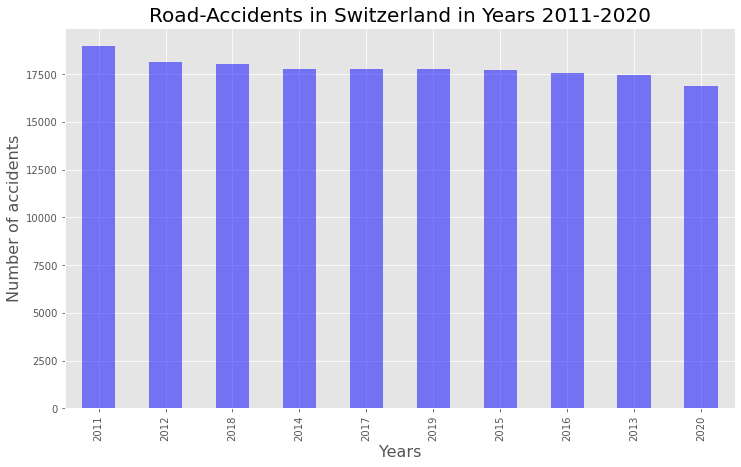

In [9]:
#Number of accidents on swiss roads seems stable, although it decreased in 2020 – probably due to Corona (more home office, less tourists driving through,...)
no_of_accident = df['AccidentYear'].value_counts()

plt.style.use('ggplot')

# plot accidents per month
no_of_accident.plot(kind='bar',figsize=(12,7), color='blue', alpha=0.5)

# title and x,y labels
plt.title('Road-Accidents in Switzerland in Years 2011-2020', fontsize=20)
plt.xlabel('Years',fontsize=16)
plt.ylabel('Number of accidents',fontsize=16);

In [10]:
#Finding out how serious the accidents were and plotting them directly. 
#as1 Unfall mit Getöteten
#as2 Unfall mit Schwerverletzten
#as3 Unfall mit Leichtverletzten
df['AccidentSeverityCategory'].value_counts()

as3    138868
as2     36954
as1      2395
Name: AccidentSeverityCategory, dtype: int64

Text(0, 0.5, '')

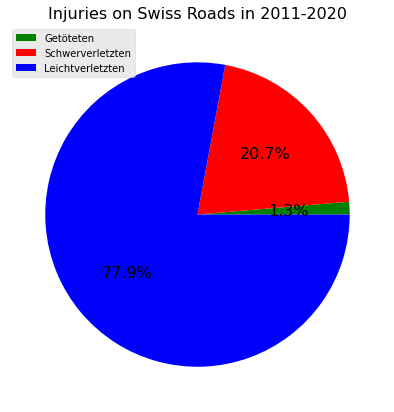

In [11]:
#Plottiny the accidents. Every fifth accident was severe or deadly. That's more than I expected.

# Serie with number of Getöteten, Schwerverletzten and Leichtverletzten
injuries = df.groupby('AccidentSeverityCategory').size()

# Pie plot with the percentage of victims with mild and serious injuries
injuries.plot(kind='pie',figsize=(7,7), colors=['green','red','blue'], labels=None, autopct='%1.1f%%', fontsize=16)

# Legend and title
plt.legend(labels=['Getöteten', 'Schwerverletzten','Leichtverletzten'])
plt.title('Injuries on Swiss Roads in 2011-2020', fontsize=16)
plt.ylabel('')

# How did the number of pedestrian accidents (AccidentType == at8) change over the years and how severe where they? 

In [12]:
#I'm also looking at pedestrian accidents specifically since that's an area where maybe improvment can be done rather easily. 
#There were around 20'580 pedestrian accidents. Of those, over 25% were severe or deadly. That's worse than accidents that don't involve pedestrians.  
df[df['AccidentType'] == 'at8']['AccidentSeverityCategory'].value_counts()   

as3    14358
as2     5716
as1      506
Name: AccidentSeverityCategory, dtype: int64

Text(0, 0.5, 'Accident')

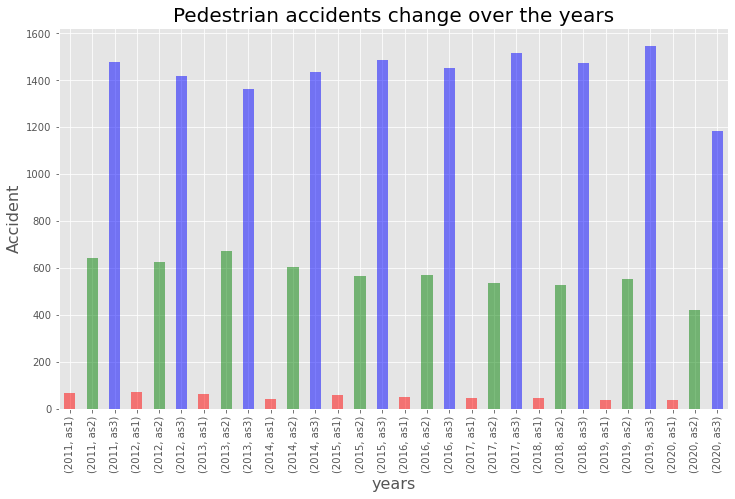

In [13]:
#The amount of pedestrian accidents also went back in 2020, probably due to lockdown and less cars on the street. 
Acc_type= df.loc[df['AccidentType'] =='at8'].groupby(['AccidentYear','AccidentSeverityCategory']).size()
Acc_type
Acc_type.plot(kind='bar',figsize=(12,7),color=['red','green','blue'],alpha=0.5)
plt.title('Pedestrian accidents change over the years',fontsize=20)
plt.xlabel('years',fontsize=16)
plt.ylabel('Accident',fontsize=16)

# Transforming EPSG:2056 to EPSG:4326

In [3]:
#In order to look at the data more precise I need to visualize them on a map. First I need to transform the Longitude-Latidude-Data from EPSG:2056 to EPSG:4326
transformer = Transformer.from_crs("epsg:2056", "epsg:4326")
lat_log = []

for i in range(len(df)): 
    r = transformer.transform(df['AccidentLocation_CHLV95_E'][i], df['AccidentLocation_CHLV95_N'][i])
    
    lat_log.append(r)
lat_log    

[(47.36851151599119, 8.52932023580764),
 (46.200474699929025, 6.154034446986602),
 (47.142560187981765, 7.241844088069813),
 (47.54182048785477, 7.602153351233706),
 (45.934254393210885, 8.898091115125267),
 (47.36975553615249, 8.51368202985955),
 (45.99573039713621, 8.917417328648844),
 (46.097025239107, 7.22541131138367),
 (46.24936113881129, 9.011358650794847),
 (46.68859376359456, 6.643035613881113),
 (45.86327244634547, 8.98125744766737),
 (46.43524647491881, 6.918492418179136),
 (46.6671104974156, 9.569946740432265),
 (46.83400400884984, 9.34248185484757),
 (47.36340256622338, 8.42315853637464),
 (47.36654232143498, 8.540613265621232),
 (46.61215561275357, 7.674179948255796),
 (47.06876706466508, 8.28204774813563),
 (46.49314969300357, 6.891155097440284),
 (47.07912191087657, 8.290440814219673),
 (46.10221039441074, 7.073184305689691),
 (47.210821297426406, 7.7376345287032064),
 (47.40467598609381, 8.55711586690878),
 (47.39543114213955, 8.6402334056748),
 (47.54214571453622, 8.9

In [4]:
#Here im adding latitude & Longtitude columns to the previous dataset
df1 = pd.DataFrame(lat_log, columns =['latitude', 'longitude'])
df1
df = pd.concat([df, df1], axis=1)
df

,AccidentUID,AccidentType,AccidentType_de,AccidentType_fr,AccidentType_it,AccidentType_en,AccidentSeverityCategory,AccidentSeverityCategory_de,AccidentSeverityCategory_fr,AccidentSeverityCategory_it,...,AccidentWeekDay,AccidentWeekDay_de,AccidentWeekDay_fr,AccidentWeekDay_it,AccidentWeekDay_en,AccidentHour,AccidentHour_text,geometry,latitude,longitude
0,9FD6441F802C20A6E0430A865E3320A6,at0,Schleuder- oder Selbstunfall,dérapage ou perte de maîtrise,Incidente di sbandamento o per colpa propria,Accident with skidding or self-accident,as3,Unfall mit Leichtverletzten,accident avec blessés légers,Incidente con feriti leggeri,...,aw406,Samstag,samedi,Sabato,Saturday,1,01h-02h,None,47.368512,8.529320
1,99AE7B25356510B0E0430A865E3310B0,at4,Einbiegeunfall,accident en s'engageant sur une route,Incidente nell’immettersi in una strada,Accident when turning-into main road,as3,Unfall mit Leichtverletzten,accident avec blessés légers,Incidente con feriti leggeri,...,aw406,Samstag,samedi,Sabato,Saturday,1,01h-02h,None,46.200475,6.154034
2,9A096471BA579094E0430A865E339094,at00,Andere,autres,Altri,Other,as2,Unfall mit Schwerverletzten,accident avec blessés graves,Incidente con feriti gravi,...,aw406,Samstag,samedi,Sabato,Saturday,2,02h-03h,None,47.142560,7.241844
3,9B1F49744917E014E0430A865E33E014,at3,Abbiegeunfall,accident en quittant une route,Incidente nello svoltare,Accident when turning left or right,as3,Unfall mit Leichtverletzten,accident avec blessés légers,Incidente con feriti leggeri,...,aw406,Samstag,samedi,Sabato,Saturday,2,02h-03h,None,47.541820,7.602153
4,99B6C7F3285BB044E0430A865E33B044,at0,Schleuder- oder Selbstunfall,dérapage ou perte de maîtrise,Incidente di sbandamento o per colpa propria,Accident with skidding or self-accident,as2,Unfall mit Schwerverletzten,accident avec blessés graves,Incidente con feriti gravi,...,aw406,Samstag,samedi,Sabato,Saturday,2,02h-03h,None,45.934254,8.898091
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
178212,B9523315B38022EBE053DDB9D80AC56B,at0,Schleuder- oder Selbstunfall,dérapage ou perte de maîtrise,Incidente di sbandamento o per colpa propria,Accident with skidding or self-accident,as3,Unfall mit Leichtverletzten,accident avec blessés légers,Incidente con feriti leggeri,...,aw404,Donnerstag,jeudi,Giovedì,Thursday,18,18h-19h,None,47.397295,8.065893
178213,BA40D09477432C94E053DDB9D80A35C6,at2,Auffahrunfall,accident par tamponnement,Incidente di tamponamento,Accident with rear-end collision,as3,Unfall mit Leichtverletzten,accident avec blessés légers,Incidente con feriti leggeri,...,aw404,Donnerstag,jeudi,Giovedì,Thursday,19,19h-20h,None,47.289965,7.737786
178214,BA42DAB30FE9FD72E053DDB9D80A1A1A,at0,Schleuder- oder Selbstunfall,dérapage ou perte de maîtrise,Incidente di sbandamento o per colpa propria,Accident with skidding or self-accident,as3,Unfall mit Leichtverletzten,accident avec blessés légers,Incidente con feriti leggeri,...,aw404,Donnerstag,jeudi,Giovedì,Thursday,19,19h-20h,None,47.141973,6.977802
178215,BA40D09476932C94E053DDB9D80A35C6,at8,Fussgängerunfall,accident impliquant des piétons,Incidente con pedoni,Accident involving pedestrian(s),as1,Unfall mit Getöteten,accident avec tués,Incidente con persone decedute,...,aw404,Donnerstag,jeudi,Giovedì,Thursday,22,22h-23h,None,47.116619,7.661765


In [11]:
df['Punkt'] = df.apply(lambda row: Point(row['longitude'], row['latitude']), axis=1)

# Merging Data with Pure_str.csv file

In [12]:
#Base column to be merged with new data
df['AccidentLocation_CHLV95_N']

0         1246980
1         1117371
2         1221306
3         1265690
4         1088015
           ...   
178212    1249797
178213    1237718
178214    1221325
178215    1218427
178216    1268291
Name: AccidentLocation_CHLV95_N, Length: 178217, dtype: object

In [13]:
#new data
df2= pd.read_csv(r"C:\Users\Keith Martins\OneDrive\Documents\PYTHON\FIVERR PROJECTS\Road Accidents in SwitzerLand\TheMostDangerousSwissRoad-main\TheMostDangerousSwissRoad-main\Data\pure_str.csv", sep=";")
df2.head()

,STR_ESID,STN_LABEL,ZIP_LABEL,COM_FOSNR,COM_NAME,COM_CANTON,STR_TYPE,STR_STATUS,STR_OFFICIAL,STR_VALID,STR_MODIFIED,STR_EASTING,STR_NORTHING
0,10062747,Alpinaweg,8784 Braunwald,1631,Glarus Süd,GL,Street,real,True,True,07.04.2021,2718803.0,1199848.0
1,10089170,Nordstrasse,8750 Glarus,1632,Glarus,GL,Street,real,True,True,07.04.2021,2723368.0,1212051.0
2,10238446,Panoramaweg,8874 Mühlehorn,1630,Glarus Nord,GL,Street,real,True,True,07.04.2021,2732027.0,1219801.0
3,10204832,Oberblegi,8775 Luchsingen,1631,Glarus Süd,GL,Area,real,True,True,07.04.2021,2720309.0,1204175.0
4,10021222,Bruggli,8754 Netstal,1632,Glarus,GL,Street,real,True,True,07.04.2021,2722654.0,1213161.0


In [14]:
df2.columns

Index(['STR_ESID', 'STN_LABEL', 'ZIP_LABEL', 'COM_FOSNR', 'COM_NAME',
       'COM_CANTON', 'STR_TYPE', 'STR_STATUS', 'STR_OFFICIAL', 'STR_VALID',
       'STR_MODIFIED', 'STR_EASTING', 'STR_NORTHING'],
      dtype='object')

In [15]:
#extracting columns we need from new data and store in df_temp
df_temp=df2[['STN_LABEL','STR_NORTHING','COM_NAME','STR_EASTING','STR_ESID']]

In [16]:
#converting AccidentLocation_CHLV95_N to float. Previously it was object type
df['AccidentLocation_CHLV95_N']=df['AccidentLocation_CHLV95_N'].astype(float)
df['AccidentLocation_CHLV95_E']=df['AccidentLocation_CHLV95_E'].astype(float)

In [17]:
#Now we can merge
#df_merged=pd.merge(df, df_temp, left_on=["AccidentLocation_CHLV95_N","AccidentLocation_CHLV95_E"],right_on=["STR_NORTHING","STR_EASTING"])
df_merged=pd.merge(df, df_temp, left_on=["AccidentLocation_CHLV95_N"],right_on=["STR_NORTHING"],how='left')
df_merged[['AccidentLocation_CHLV95_N','AccidentLocation_CHLV95_E','STR_NORTHING','STR_EASTING','STN_LABEL','COM_NAME','latitude','longitude','Punkt']]

,AccidentLocation_CHLV95_N,AccidentLocation_CHLV95_E,STR_NORTHING,STR_EASTING,STN_LABEL,COM_NAME,latitude,longitude,Punkt
0,1246980.0,2682382.0,1246980.0,2681697.0,Gotthelfstrasse,Zürich,47.368512,8.529320,POINT (8.52932023580764 47.36851151599119)
1,1117371.0,2500845.0,1117371.0,2501216.0,Carrefour de Villereuse,Genève,46.200475,6.154034,POINT (6.154034446986602 46.20047469992902)
2,1221306.0,2585073.0,1221306.0,2671643.0,Iberg,Inwil,47.142560,7.241844,POINT (7.241844088069813 47.14256018798176)
3,1265690.0,2612312.0,1265690.0,2605219.0,Libsbachmühleweg,Schönenbuch,47.541820,7.602153,POINT (7.602153351233706 47.54182048785477)
4,1088015.0,2713199.0,1088015.0,2720358.0,Strecia dal Riaa,Rovio,45.934254,8.898091,POINT (8.898091115125267 45.93425439321089)
...,...,...,...,...,...,...,...,...,...
329354,1237718.0,2622630.0,NaN,NaN,NaN,NaN,47.289965,7.737786,POINT (7.737785887822909 47.28996476392248)
329355,1221325.0,2565044.0,NaN,NaN,NaN,NaN,47.141973,6.977802,POINT (6.977801619502515 47.14197334408194)
329356,1218427.0,2616934.0,NaN,NaN,NaN,NaN,47.116619,7.661765,POINT (7.661764848135851 47.11661926939236)
329357,1268291.0,2738486.0,1268291.0,2711972.0,Kuhtobel,Frauenfeld,47.550728,9.278507,POINT (9.27850749620211 47.55072766884274)


In [18]:
df_merged.columns

Index(['AccidentUID', 'AccidentType', 'AccidentType_de', 'AccidentType_fr',
       'AccidentType_it', 'AccidentType_en', 'AccidentSeverityCategory',
       'AccidentSeverityCategory_de', 'AccidentSeverityCategory_fr',
       'AccidentSeverityCategory_it', 'AccidentSeverityCategory_en',
       'AccidentInvolvingPedestrian', 'AccidentInvolvingBicycle',
       'AccidentInvolvingMotorcycle', 'RoadType', 'RoadType_de', 'RoadType_fr',
       'RoadType_it', 'RoadType_en', 'AccidentLocation_CHLV95_E',
       'AccidentLocation_CHLV95_N', 'CantonCode', 'MunicipalityCode',
       'AccidentYear', 'AccidentMonth', 'AccidentMonth_de', 'AccidentMonth_fr',
       'AccidentMonth_it', 'AccidentMonth_en', 'AccidentWeekDay',
       'AccidentWeekDay_de', 'AccidentWeekDay_fr', 'AccidentWeekDay_it',
       'AccidentWeekDay_en', 'AccidentHour', 'AccidentHour_text', 'geometry',
       'latitude', 'longitude', 'Punkt', 'STN_LABEL', 'STR_NORTHING',
       'COM_NAME', 'STR_EASTING', 'STR_ESID'],
      dtype='obje

In [19]:
df_merged = df_merged[df_merged['STR_NORTHING'].notna()]
df_merged.head()

,AccidentUID,AccidentType,AccidentType_de,AccidentType_fr,AccidentType_it,AccidentType_en,AccidentSeverityCategory,AccidentSeverityCategory_de,AccidentSeverityCategory_fr,AccidentSeverityCategory_it,...,AccidentHour_text,geometry,latitude,longitude,Punkt,STN_LABEL,STR_NORTHING,COM_NAME,STR_EASTING,STR_ESID
0,9FD6441F802C20A6E0430A865E3320A6,at0,Schleuder- oder Selbstunfall,dérapage ou perte de maîtrise,Incidente di sbandamento o per colpa propria,Accident with skidding or self-accident,as3,Unfall mit Leichtverletzten,accident avec blessés légers,Incidente con feriti leggeri,...,01h-02h,None,47.368512,8.529320,POINT (8.52932023580764 47.36851151599119),Gotthelfstrasse,1246980.0,Zürich,2681697.0,10098543.0
1,99AE7B25356510B0E0430A865E3310B0,at4,Einbiegeunfall,accident en s'engageant sur une route,Incidente nell’immettersi in una strada,Accident when turning-into main road,as3,Unfall mit Leichtverletzten,accident avec blessés légers,Incidente con feriti leggeri,...,01h-02h,None,46.200475,6.154034,POINT (6.154034446986602 46.20047469992902),Carrefour de Villereuse,1117371.0,Genève,2501216.0,10113949.0
2,9A096471BA579094E0430A865E339094,at00,Andere,autres,Altri,Other,as2,Unfall mit Schwerverletzten,accident avec blessés graves,Incidente con feriti gravi,...,02h-03h,None,47.142560,7.241844,POINT (7.241844088069813 47.14256018798176),Iberg,1221306.0,Inwil,2671643.0,10185154.0
3,9B1F49744917E014E0430A865E33E014,at3,Abbiegeunfall,accident en quittant une route,Incidente nello svoltare,Accident when turning left or right,as3,Unfall mit Leichtverletzten,accident avec blessés légers,Incidente con feriti leggeri,...,02h-03h,None,47.541820,7.602153,POINT (7.602153351233706 47.54182048785477),Libsbachmühleweg,1265690.0,Schönenbuch,2605219.0,10056299.0
4,99B6C7F3285BB044E0430A865E33B044,at0,Schleuder- oder Selbstunfall,dérapage ou perte de maîtrise,Incidente di sbandamento o per colpa propria,Accident with skidding or self-accident,as2,Unfall mit Schwerverletzten,accident avec blessés graves,Incidente con feriti gravi,...,02h-03h,None,45.934254,8.898091,POINT (8.898091115125267 45.93425439321089),Strecia dal Riaa,1088015.0,Rovio,2720358.0,10174208.0


# PROBLEM: LONG/LAT DON'T MATCH ADRESSES

#First Result (0) should show Gotthelfstrasse in Zurich (see cell above). But if I control it with https://www.gpskoordinaten.de/ (or similar tools) it shows Tunnelstrasse for the coordinates 47.368512/8.529320 which is a few meters next to it (see image below). Happens with almost all results, they are a few meters or kilometers away.

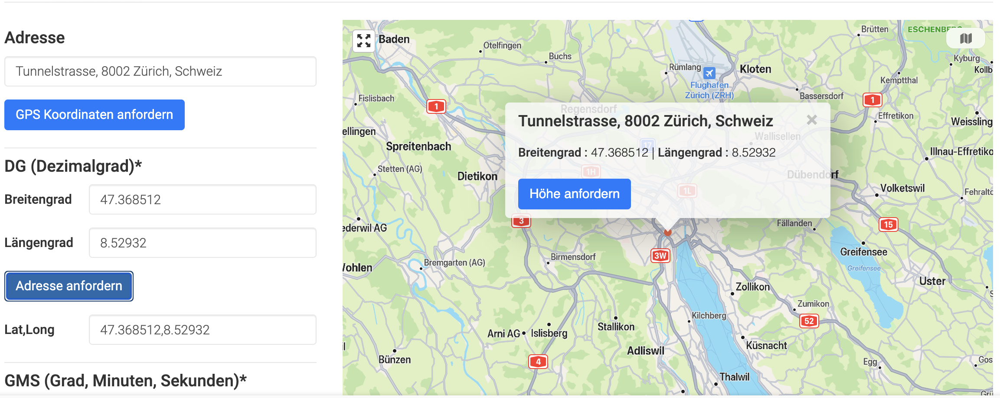# 

#Only 39 results are same on East and North-Coordinates but even that doesn't necessarily mean the accident-spot is correct. 
#Therefore I rather continue using the whole file just to have more datapoints instead of merging by East and North coordinates. 
#Code for merging both would be: 
#df_merged=pd.merge(df, df_temp, left_on=["AccidentLocation_CHLV95_N","AccidentLocation_CHLV95_E"],right_on=["STR_NORTHING","STR_EASTING"])
#df_merged[['AccidentLocation_CHLV95_N','AccidentLocation_CHLV95_E','STR_NORTHING','STR_EASTING','STN_LABEL','COM_NAME']]

# What streets are the most dangerous?

In [20]:
#eventhough the spots aren't correct, I can still try to find the most dangerous street. I wanna show the streets where most deadly accidents (as1) happened between 2011 and 2020. 
#Results are disappointing from journalistic standpoint, nothing standing out.
d_grouped=df_merged.loc[df_merged['AccidentSeverityCategory']=='as1'].groupby(['STN_LABEL', 'AccidentSeverityCategory','COM_NAME']).size().sort_values(ascending=False)
d_grouped.head(10)

STN_LABEL               AccidentSeverityCategory  COM_NAME              
Müselbachstrasse        as1                       Mosnang                   2
Schalchenstrasse        as1                       Pfäffikon                 2
Unterholzstrasse        as1                       Meikirch                  2
Chemin de Neyruz        as1                       Riaz                      2
Geissberg               as1                       Bütschwil-Ganterschwil    2
Blumenweg               as1                       Lengnau (AG)              2
Route de Formangueires  as1                       Belfaux                   2
Oberhüsli               as1                       Hergiswil bei Willisau    2
Kammenhütte             as1                       Sumiswald                 2
Lindenweg               as1                       Au (SG)                   2
dtype: int64

Text(0, 0.5, '# of Accidents')

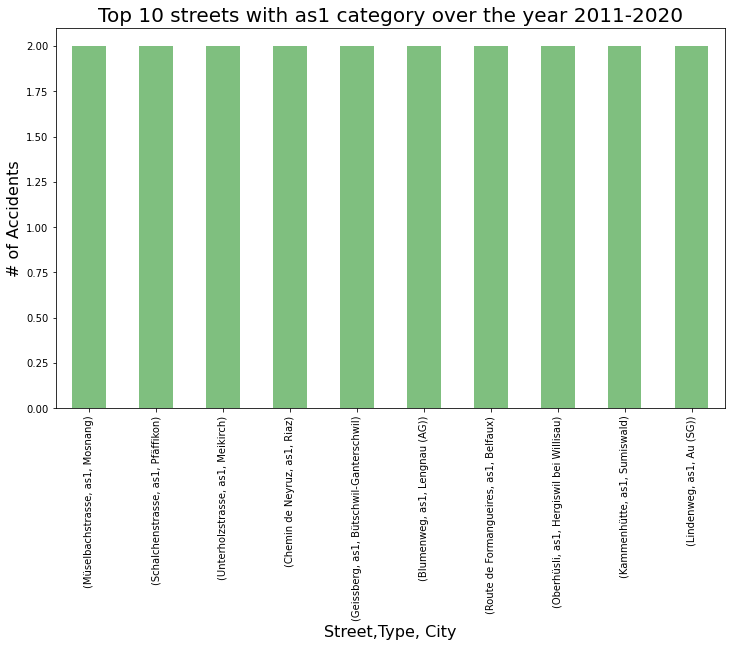

In [21]:
#plotting the streets
d_grouped.head(10).plot(kind='bar',figsize=(12,7),color=['green'],alpha=0.5)
plt.title('Top 10 streets with as1 category over the year 2011-2020',fontsize=20)
plt.xlabel('Street,Type, City',fontsize=16)
plt.ylabel('# of Accidents',fontsize=16)

# Displaying results on map

In [22]:
#Eventhough it doesn't work and therefore I can't to the analysis I want #Analyzing the street names didn't do anything for me. But I can still show the deadly accidents on a map. Clustering them in a way that has more value than the analysis above. 

In [23]:
#Here I first I grouped the merged dataframe. 
#Then renamed the column 0 to #of accidents.
#Then again I had to merge this newly(df_merged_map) created dataframe with the large df_merged dataframe. 
#And filtered out all the information needed for the rows of d_grouped_map.
d_grouped_map=df_merged.loc[df_merged['AccidentSeverityCategory']=='as1'].groupby(['STN_LABEL', 'AccidentSeverityCategory','COM_NAME']).size().sort_values(ascending=False)
d_grouped_map=pd.DataFrame(d_grouped_map)
d_grouped_map=d_grouped_map.rename(columns={0:"# of accidents"})
d_grouped_map=d_grouped_map.reset_index()
d_grouped_map=pd.merge(d_grouped_map, df_merged, left_on=["AccidentSeverityCategory","STN_LABEL","COM_NAME"],right_on=["AccidentSeverityCategory","STN_LABEL","COM_NAME"],how='left')
d_grouped_map = d_grouped_map[d_grouped_map['# of accidents'].notna()]
d_grouped_map=d_grouped_map.sort_values(by='# of accidents',ascending=False)
d_grouped_map=d_grouped_map.drop_duplicates(subset=['STN_LABEL', 'AccidentSeverityCategory','COM_NAME'], keep='first')
d_grouped_map=d_grouped_map.reset_index()
d_grouped_map

,index,STN_LABEL,AccidentSeverityCategory,COM_NAME,# of accidents,AccidentUID,AccidentType,AccidentType_de,AccidentType_fr,AccidentType_it,...,AccidentWeekDay_en,AccidentHour,AccidentHour_text,geometry,latitude,longitude,Punkt,STR_NORTHING,STR_EASTING,STR_ESID
0,0,Müselbachstrasse,as1,Mosnang,2,8081CFEBE80865FBE05328B9D80A0F58,at4,Einbiegeunfall,accident en s'engageant sur une route,Incidente nell’immettersi in una strada,...,Monday,9,09h-10h,None,47.386531,8.075196,POINT (8.07519564519408 47.38653135884967),1248606.0,2719424.0,10092726.0
1,64,Haldenstrasse,as1,Thürnen,2,A0BA6B6E91B850C4E0430A865E3350C4,at6,Frontalkollision,collision frontale,Collisione frontale,...,Wednesday,5,05h-06h,None,47.455724,7.747110,POINT (7.747109550171687 47.45572376328197),1256150.0,2629353.0,10190885.0
2,74,Stegbachstrasse,as1,Obergösgen,2,A3C8388F06C46174E05328B9D80A5A12,at0,Schleuder- oder Selbstunfall,dérapage ou perte de maîtrise,Incidente di sbandamento o per colpa propria,...,Wednesday,19,19h-20h,None,47.363742,8.575269,POINT (8.575268601857397 47.3637417600046),1246499.0,2639388.0,10023652.0
3,73,Bodenackerstrasse,as1,Breitenbach,2,B2D0395F65CE67C6E05329B9D80A373F,at4,Einbiegeunfall,accident en s'engageant sur une route,Incidente nell’immettersi in una strada,...,Thursday,6,06h-07h,None,47.403329,7.806753,POINT (7.806753336145236 47.4033293511877),1250344.0,2607990.0,10124519.0
4,71,Unterer Mettenbühlweg,as1,Breitenbach,2,36F72F66339701BCE0530A839427BACF,at8,Fussgängerunfall,accident impliquant des piétons,Incidente con pedoni,...,Thursday,13,13h-14h,None,47.407140,7.543567,POINT (7.543566988628456 47.40714012110105),1250708.0,2608573.0,10089860.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3513,1258,Zenzachweg,as1,Wintersingen,1,CC52A5A1D21D007CE0430A839427A9A3,at3,Abbiegeunfall,accident en quittant une route,Incidente nello svoltare,...,Tuesday,13,13h-14h,None,47.487267,8.758716,POINT (8.758715830213838 47.48726693080251),1260448.0,2629393.0,10096326.0
3514,1259,Ziefenstrasse,as1,Reigoldswil,1,080A424CF2690176E0530A8394271607,at8,Fussgängerunfall,accident impliquant des piétons,Incidente con pedoni,...,Friday,14,14h-15h,None,47.403867,8.402244,POINT (8.402244378261422 47.40386714329048),1250785.0,2619112.0,10161935.0
3515,1260,Ziefenstrasse,as1,Seewen,1,3567A2A8185A0202E0530A839427461B,at0,Schleuder- oder Selbstunfall,dérapage ou perte de maîtrise,Incidente di sbandamento o per colpa propria,...,Monday,20,20h-21h,None,47.417583,7.810416,POINT (7.810416311841448 47.41758254396596),1251930.0,2617356.0,10213193.0
3516,1261,Ziegelackerstrasse,as1,Bern,1,D418F12FD4850242E0430A83942787C5,at6,Frontalkollision,collision frontale,Collisione frontale,...,Wednesday,23,23h-00h,None,46.947488,8.011111,POINT (8.01111077631832 46.94748841065303),1199759.0,2597207.0,10083220.0


# Plottly Scatter Geo Approach

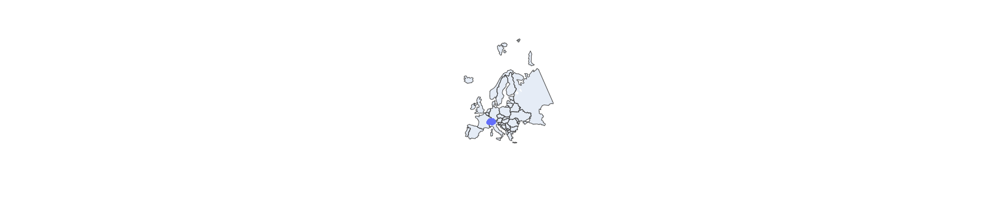

In [20]:
#Tried with Plotly scatter geo approach. I could plot the points (deadly accidents) successfully and show them on a european Map. But Swtizerland could not be marked and the streets also could not be marked. And it looks ugly. 
import plotly.express as px
import geopandas as gpd
import plotly.graph_objects as go
geo_df = gpd.GeoDataFrame(df_merged, geometry='Punkt')
geo_df_temp=geo_df.loc[(geo_df['AccidentSeverityCategory']=='as1')]
#geo_df_temp.plot()
fig = px.scatter_geo(geo_df_temp,
                    lat=geo_df_temp.latitude,
                    lon=geo_df_temp.longitude,
                    hover_name="STN_LABEL",
                    #  locationmode = ''
)
fig.update_geos(
    scope='europe',
    showcountries=True
)
# fig.update_geos()
# fig.update_layout(
#         geo_scope='europe',
#     )
fig.show()

# Folium – best approach

In [29]:
#Found the library folium which allows to visualize Data it in a Leaflet map.
import folium

# Define a map centered around Switzerland
Switzerland_map = folium.Map(location=[46.8182, 8.2275], zoom_start=8)
Switzerland_map

# Showing Deadly Accidents 2011-2020 on Map

In [31]:
#Looks great therefore continuing with it. Creating a map with deadly accidents over the year
geo_df = gpd.GeoDataFrame(df_merged, geometry='Punkt')
geo_df_temp=geo_df.loc[(geo_df['AccidentSeverityCategory']=='as1')]
map_osm = folium.Map(
    location = [46.8182, 8.2275],
    zoom_start = 12
)
map_osm

#Marker for points on Map. Zoom in or out and click on markers for more details about an accident. 
for indice, row in geo_df_temp.iterrows():
    folium.Marker(
        location=[row["latitude"], row["longitude"]],
        popup="Street Name: "+row['STN_LABEL']+" Category: "+row['AccidentSeverityCategory'],
        icon=folium.map.Icon(color='yellow')
    ).add_to(map_osm)
map_osm


In [32]:
#Happy with the result but it's still tough to see where most accidents happened. 
#Therefore added a solution to group markers into different clusters using the MarkerCluster object. 

from folium import plugins

# Creating a map object of Switzerland
swiss_map= folium.Map(location=[46.8182, 8.2275], zoom_start=12)

# Creating a mark cluster object for the car accidents
accidents = plugins.MarkerCluster().add_to(swiss_map)

# Display only accidents where deadly injuries where recorded
for lat, lng, label in zip(d_grouped_map.latitude, d_grouped_map.longitude, d_grouped_map['# of accidents'].astype(str)):
    if label!='0':
        folium.Marker(
            location=[lat, lng],
            icon=None,
            popup=label,
        ).add_to(accidents)
swiss_map

In [24]:
#Sadly there is one more problem: It shows 3518 deadly accidents in Switzerland between 2011 and 2020. 
#But there should only be 2395. 
as1 = df["AccidentSeverityCategory"].value_counts().sort_values(ascending=False)
as1


as3    138868
as2     36954
as1      2395
Name: AccidentSeverityCategory, dtype: int64

In [31]:
#My best guess: Several streets have same latitude/longitude, thus it came to repetitions when grouping by them. Sadly time run out to look at this problem.  

In [25]:
df["AccidentSeverityCategory"].count()

178217

#### Solution to the Problem  (Reverse Geocoding)

In [26]:
from geopy.geocoders import Nominatim
import plotly_express as px
from tqdm import tqdm

In [27]:
d_grouped_map['longitude']

0       8.075196
1       7.747110
2       8.575269
3       7.806753
4       7.543567
          ...   
3513    8.758716
3514    8.402244
3515    7.810416
3516    8.011111
3517    7.495743
Name: longitude, Length: 3518, dtype: float64

In [28]:
px.scatter_mapbox(d_grouped_map, lat="latitude", lon="longitude", zoom = 15)

In [29]:
d_grouped_map['geom'] = d_grouped_map['latitude'].map(str) + ',' + d_grouped_map['longitude'].map(str)
d_grouped_map['geom'][0]

'47.386531358849666,8.07519564519408'

In [30]:
locator = Nominatim(user_agent="myGeocoder", timeout=10)
rgeocode= RateLimiter(locator.reverse, min_delay_seconds=0.001)

In [31]:
tqdm.pandas()

d_grouped_map['address'] = d_grouped_map['geom'].progress_apply(rgeocode)
d_grouped_map.head()

 57%|█████▋    | 2001/3518 [16:42<12:31,  2.02it/s]RateLimiter caught an error, retrying (0/2 tries). Called with (*('47.43090446952864,8.54413256150087',), **{}).
Traceback (most recent call last):
  File "C:\Users\Keith Martins\anaconda3\lib\site-packages\geopy\geocoders\base.py", line 368, in _call_geocoder
    result = self.adapter.get_json(url, timeout=timeout, headers=req_headers)
  File "C:\Users\Keith Martins\anaconda3\lib\site-packages\geopy\adapters.py", line 438, in get_json
    resp = self._request(url, timeout=timeout, headers=headers)
  File "C:\Users\Keith Martins\anaconda3\lib\site-packages\geopy\adapters.py", line 466, in _request
    raise AdapterHTTPError(
geopy.adapters.AdapterHTTPError: Non-successful status code 403

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "C:\Users\Keith Martins\anaconda3\lib\site-packages\geopy\extra\rate_limiter.py", line 136, in _retries_gen
    yield i  # Run the function

,index,STN_LABEL,AccidentSeverityCategory,COM_NAME,# of accidents,AccidentUID,AccidentType,AccidentType_de,AccidentType_fr,AccidentType_it,...,AccidentHour_text,geometry,latitude,longitude,Punkt,STR_NORTHING,STR_EASTING,STR_ESID,geom,address
0,0,Müselbachstrasse,as1,Mosnang,2,8081CFEBE80865FBE05328B9D80A0F58,at4,Einbiegeunfall,accident en s'engageant sur une route,Incidente nell’immettersi in una strada,...,09h-10h,None,47.386531,8.075196,POINT (8.07519564519408 47.38653135884967),1248606.0,2719424.0,10092726.0,"47.386531358849666,8.07519564519408","(Bühlstrasse, Oberdorf, Buchs, Bezirk Aarau, A..."
1,64,Haldenstrasse,as1,Thürnen,2,A0BA6B6E91B850C4E0430A865E3350C4,at6,Frontalkollision,collision frontale,Collisione frontale,...,05h-06h,None,47.455724,7.747110,POINT (7.747109550171687 47.45572376328197),1256150.0,2629353.0,10190885.0,"47.455723763281966,7.747109550171687","(Formex AG, Obere Hauensteinstrassesse, Im Teu..."
2,74,Stegbachstrasse,as1,Obergösgen,2,A3C8388F06C46174E05328B9D80A5A12,at0,Schleuder- oder Selbstunfall,dérapage ou perte de maîtrise,Incidente di sbandamento o per colpa propria,...,19h-20h,None,47.363742,8.575269,POINT (8.575268601857397 47.3637417600046),1246499.0,2639388.0,10023652.0,"47.3637417600046,8.575268601857397","(Witikonerstrasse, Hirslanden, Kreis 7, Zürich..."
3,73,Bodenackerstrasse,as1,Breitenbach,2,B2D0395F65CE67C6E05329B9D80A373F,at4,Einbiegeunfall,accident en s'engageant sur une route,Incidente nell’immettersi in una strada,...,06h-07h,None,47.403329,7.806753,POINT (7.806753336145236 47.4033293511877),1250344.0,2607990.0,10124519.0,"47.4033293511877,7.806753336145236","(Diegten, Bezirk Waldenburg, Basel-Landschaft,..."
4,71,Unterer Mettenbühlweg,as1,Breitenbach,2,36F72F66339701BCE0530A839427BACF,at8,Fussgängerunfall,accident impliquant des piétons,Incidente con pedoni,...,13h-14h,None,47.407140,7.543567,POINT (7.543566988628456 47.40714012110105),1250708.0,2608573.0,10089860.0,"47.40714012110105,7.543566988628456","(2, Alice Vogt-Strasse, Breitenbach, Bezirk Th..."


In [32]:
d_grouped_map.head()

,index,STN_LABEL,AccidentSeverityCategory,COM_NAME,# of accidents,AccidentUID,AccidentType,AccidentType_de,AccidentType_fr,AccidentType_it,...,AccidentHour_text,geometry,latitude,longitude,Punkt,STR_NORTHING,STR_EASTING,STR_ESID,geom,address
0,0,Müselbachstrasse,as1,Mosnang,2,8081CFEBE80865FBE05328B9D80A0F58,at4,Einbiegeunfall,accident en s'engageant sur une route,Incidente nell’immettersi in una strada,...,09h-10h,None,47.386531,8.075196,POINT (8.07519564519408 47.38653135884967),1248606.0,2719424.0,10092726.0,"47.386531358849666,8.07519564519408","(Bühlstrasse, Oberdorf, Buchs, Bezirk Aarau, A..."
1,64,Haldenstrasse,as1,Thürnen,2,A0BA6B6E91B850C4E0430A865E3350C4,at6,Frontalkollision,collision frontale,Collisione frontale,...,05h-06h,None,47.455724,7.747110,POINT (7.747109550171687 47.45572376328197),1256150.0,2629353.0,10190885.0,"47.455723763281966,7.747109550171687","(Formex AG, Obere Hauensteinstrassesse, Im Teu..."
2,74,Stegbachstrasse,as1,Obergösgen,2,A3C8388F06C46174E05328B9D80A5A12,at0,Schleuder- oder Selbstunfall,dérapage ou perte de maîtrise,Incidente di sbandamento o per colpa propria,...,19h-20h,None,47.363742,8.575269,POINT (8.575268601857397 47.3637417600046),1246499.0,2639388.0,10023652.0,"47.3637417600046,8.575268601857397","(Witikonerstrasse, Hirslanden, Kreis 7, Zürich..."
3,73,Bodenackerstrasse,as1,Breitenbach,2,B2D0395F65CE67C6E05329B9D80A373F,at4,Einbiegeunfall,accident en s'engageant sur une route,Incidente nell’immettersi in una strada,...,06h-07h,None,47.403329,7.806753,POINT (7.806753336145236 47.4033293511877),1250344.0,2607990.0,10124519.0,"47.4033293511877,7.806753336145236","(Diegten, Bezirk Waldenburg, Basel-Landschaft,..."
4,71,Unterer Mettenbühlweg,as1,Breitenbach,2,36F72F66339701BCE0530A839427BACF,at8,Fussgängerunfall,accident impliquant des piétons,Incidente con pedoni,...,13h-14h,None,47.407140,7.543567,POINT (7.543566988628456 47.40714012110105),1250708.0,2608573.0,10089860.0,"47.40714012110105,7.543566988628456","(2, Alice Vogt-Strasse, Breitenbach, Bezirk Th..."


In [33]:
d_grouped_map.to_csv(r"C:\Users\Keith Martins\OneDrive\Documents\PYTHON\FIVERR PROJECTS\Road Accidents in SwitzerLand\TheMostDangerousSwissRoad-main\TheMostDangerousSwissRoad-main\Data\Geocoded_data.csv")

PermissionError: [Errno 13] Permission denied: 'C:\\Users\\Keith Martins\\OneDrive\\Documents\\PYTHON\\FIVERR PROJECTS\\Road Accidents in SwitzerLand\\TheMostDangerousSwissRoad-main\\TheMostDangerousSwissRoad-main\\Data\\Geocoded_data.csv'

#### Resolving the  Addresses to Street name

In [54]:
d_grouped_map1 = d_grouped_map.copy()
d_grouped_map1.head()

,index,STN_LABEL,AccidentSeverityCategory,COM_NAME,# of accidents,AccidentUID,AccidentType,AccidentType_de,AccidentType_fr,AccidentType_it,...,AccidentHour_text,geometry,latitude,longitude,Punkt,STR_NORTHING,STR_EASTING,STR_ESID,geom,address
0,0,Müselbachstrasse,as1,Mosnang,2,8081CFEBE80865FBE05328B9D80A0F58,at4,Einbiegeunfall,accident en s'engageant sur une route,Incidente nell’immettersi in una strada,...,09h-10h,None,47.386531,8.075196,POINT (8.07519564519408 47.38653135884967),1248606.0,2719424.0,10092726.0,"47.386531358849666,8.07519564519408","(Bühlstrasse, Oberdorf, Buchs, Bezirk Aarau, A..."
1,64,Haldenstrasse,as1,Thürnen,2,A0BA6B6E91B850C4E0430A865E3350C4,at6,Frontalkollision,collision frontale,Collisione frontale,...,05h-06h,None,47.455724,7.747110,POINT (7.747109550171687 47.45572376328197),1256150.0,2629353.0,10190885.0,"47.455723763281966,7.747109550171687","(Formex AG, Obere Hauensteinstrassesse, Im Teu..."
2,74,Stegbachstrasse,as1,Obergösgen,2,A3C8388F06C46174E05328B9D80A5A12,at0,Schleuder- oder Selbstunfall,dérapage ou perte de maîtrise,Incidente di sbandamento o per colpa propria,...,19h-20h,None,47.363742,8.575269,POINT (8.575268601857397 47.3637417600046),1246499.0,2639388.0,10023652.0,"47.3637417600046,8.575268601857397","(Witikonerstrasse, Hirslanden, Kreis 7, Zürich..."
3,73,Bodenackerstrasse,as1,Breitenbach,2,B2D0395F65CE67C6E05329B9D80A373F,at4,Einbiegeunfall,accident en s'engageant sur une route,Incidente nell’immettersi in una strada,...,06h-07h,None,47.403329,7.806753,POINT (7.806753336145236 47.4033293511877),1250344.0,2607990.0,10124519.0,"47.4033293511877,7.806753336145236","(Diegten, Bezirk Waldenburg, Basel-Landschaft,..."
4,71,Unterer Mettenbühlweg,as1,Breitenbach,2,36F72F66339701BCE0530A839427BACF,at8,Fussgängerunfall,accident impliquant des piétons,Incidente con pedoni,...,13h-14h,None,47.407140,7.543567,POINT (7.543566988628456 47.40714012110105),1250708.0,2608573.0,10089860.0,"47.40714012110105,7.543566988628456","(2, Alice Vogt-Strasse, Breitenbach, Bezirk Th..."


In [1234]:
alphabets = ['A','B','C','D','E','F','G','H','I','J','K','L','M','N','O','P','Q','R','S','T','U','V','W','X','Y','Z', 'a','b','c','d','e','f','g','h','i','j','k','l','m','n','o','p','q','r','s','t','u','v','w','x','y','z'] 
addresses1 = d_grouped_map1['address'].to_list()
numbers = "1" #,"2","3","4","5","6","7","8","9","0"]

street_names = []
#street_representation = 'strasse' # ,  "weg", "rue", "gasse", "pass", "avenue", "via", "route", "quai","avia", "Strasse", "Weg", "Rue", "Gasse", "Pass", "Avenue", "Via", "Route", "Quai" , "Avia"
street_representation = ["strasse",  "weg", "rue", "gasse", "pass", "avenue", "via", "route", "quai","avia", "felsplatte", "tunnel",  
                         "Strasse", "Weg", "Rue", "Gasse", "Pass", "Avenue", "Via", "Route", "Quai" , "Avia", "Felsplatte", "Tunnel", "Route", "A6"]  
zip_codes = []

count=0
indexes=[]
for i,kl in zip(addresses1, d_grouped_map1.index):
        
    
    if i != None:
        
        try:
            if  i[0].split(',')[0] not in i[0].split(','):
                letter = i[0].split(',')[0][0]
            else:
                letter = i[0].split(',').remove(i[0].split(',')[0])[0][0]


            if  i[0].split(',')[1] not in i[0].split(','):
                letter2 = i[0].split(',')[1][1]
            else:
                letter2 = i[0].split(',').remove(i[0].split(',')[1])[1][1]  
                
            
        except:
            pass
        
   

        street_name = i[0].split(',')[0]
        street_name2 = i[0].split(',')[1]
        street_name3 = i[0].split(',')[2]
        
        
        for str_rep in street_representation:
        
            if str_rep in street_name:
                street_names.append(street_name)
                break
                

            elif str_rep in street_name2:
                street_names.append(street_name2)
                break
                
            
            elif str_rep not in street_name and str_rep in street_name2:                                 #and str_rep not in street_name and str_rep not in street_name2: #
                street_names.append(street_name2)
                print(street_name2)
                break
                
                
            elif str_rep not in street_name and str_rep not in street_name2 and str_rep not in street_name3:
                street_names.append(street_name2)
                break
                
                
            
            elif str_rep in street_name3:
                street_names.append(street_name3)
                break
               
            
            elif numbers in street_name[0] and numbers in street_name2[0]: 
                street_names.append(street_name3)
                break
     
    
        for m in i[0].split(","):

            try:
                if len(m) >= 4:
                    zip_codes_ = int(m)

            except:
                pass
                
        zip_codes.append(zip_codes_)
        indexes.append(kl)

In [1235]:
len(street_names),len(indexes), len(zip_codes)

(3471, 3471, 3471)

In [1238]:
d_grouped_map1.loc[indexes,'Street_Name'] = street_names
d_grouped_map1.loc[indexes, 'Zip_Codes'] = zip_codes
d_grouped_map1.tail(35) 

,index,STN_LABEL,AccidentSeverityCategory,COM_NAME,# of accidents,AccidentUID,AccidentType,AccidentType_de,AccidentType_fr,AccidentType_it,...,latitude,longitude,Punkt,STR_NORTHING,STR_EASTING,STR_ESID,geom,address,Street_Name,Zip_Codes
3483,1282,Waldhüttenstrasse,as1,Hausen am Albis,1,AE1A8B8B7277F6C6E05329B9D80A547E,at0,Schleuder- oder Selbstunfall,dérapage ou perte de maîtrise,Incidente di sbandamento o per colpa propria,...,47.225652,8.935048,POINT (8.935047821188718 47.22565161423199),1231605.0,2685174.0,10197245.0,"47.22565161423199,8.935047821188718","(Seepolizei, Strandweg, Goldberg, Schmerikon, ...",Strandweg,8716
3484,1283,Waldlehrpfad,as1,Wattwil,1,8D691651E6F586D9E05328B9D80A142F,at7,Parkierunfall,accident en parquant,Incidente nel parcheggiare,...,47.307659,8.023963,POINT (8.023963299155483 47.30765874604564),1239807.0,2723704.0,10227782.0,"47.30765874604564,8.023963299155483","(17, Schorütistrasse, Uerkheim, Bezirk Zofinge...",Schorütistrasse,4813
3485,1284,Waldmanngasse,as1,Dübendorf,1,B964E2CEC190273AE053DDB9D80AD137,at0,Schleuder- oder Selbstunfall,dérapage ou perte de maîtrise,Incidente di sbandamento o per colpa propria,...,47.370943,9.004570,POINT (9.004570326023865 47.37094311449553),1247858.0,2688013.0,10177812.0,"47.37094311449553,9.004570326023865","(Hauptstrasse, Dreien, Mosnang, Wahlkreis Togg...",Hauptstrasse,9612
3486,1285,Waldschwil,as1,Neckertal,1,FC6BA296F43A0256E0430A839427BD1B,at0,Schleuder- oder Selbstunfall,dérapage ou perte de maîtrise,Incidente di sbandamento o per colpa propria,...,47.329162,9.417116,POINT (9.417115568376069 47.32916152011972),1243918.0,2727236.0,10112062.0,"47.32916152011972,9.417115568376069","(Bleichestrasse, Steinegg, Rüte, Appenzell Inn...",Bleichestrasse,9050
3487,1286,Waldstrasse,as1,Arlesheim,1,29988BFAF1D7019CE0530A839427E9C0,at1,Überholunfall oder Fahrstreifenwechsel,accident lors d'un dépassement ou lors d'un ch...,Incidente di sorpasso o al cambiamento di corsia,...,47.483865,9.557825,POINT (9.557825327914772 47.48386544224547),1261390.0,2613956.0,10110206.0,"47.483865442245474,9.557825327914772","(7;13, Altenrhein, Thal, Wahlkreis Rorschach, ...",Altenrhein,9423
3488,1287,Waldweg,as1,Bremgarten (AG),1,C36FB9B45BFC0164E0430A83942792A0,at3,Abbiegeunfall,accident en quittant une route,Incidente nello svoltare,...,47.331621,8.579691,POINT (8.579691454523228 47.33162097957542),1242933.0,2668207.0,10239864.0,"47.33162097957542,8.579691454523228","(9, Obere Bühlstrasse, Küsnacht (ZH), Bezirk M...",Obere Bühlstrasse,8700
3489,1288,Wallerstrasse,as1,Aarau,1,F5585B8588C102F0E0430A839427870C,at8,Fussgängerunfall,accident impliquant des piétons,Incidente con pedoni,...,47.379794,8.506866,POINT (8.506865678761169 47.37979433138194),1248211.0,2645641.0,10094470.0,"47.379794331381945,8.50686567876117","(401, Badenerstrasse, Hard, Aussersihl, Zürich...",Badenerstrasse,8003
3490,1265,Zihlacker,as1,Triengen,1,2068F2A4BCE40146E0530A8394271A13,at1,Überholunfall oder Fahrstreifenwechsel,accident lors d'un dépassement ou lors d'un ch...,Incidente di sorpasso o al cambiamento di corsia,...,47.223739,9.023552,POINT (9.023551777901169 47.22373876491253),1231524.0,2648805.0,10017324.0,"47.22373876491253,9.023551777901169","(Rickenstrasse, Kaltbrunn, Wahlkreis See-Gaste...",Rickenstrasse,8722
3491,1263,Ziel-Törggeli,as1,Altstätten,1,6B9CE178C4230178E0530A839427371D,at8,Fussgängerunfall,accident impliquant des piétons,Incidente con pedoni,...,47.408174,7.543675,POINT (7.543675000624207 47.40817435407045),1250823.0,2758015.0,10227212.0,"47.40817435407045,7.543675000624207","(1/3, Central, Breitenbach, Bezirk Thierstein,...",Central,4226
3492,1238,in Geráscia da Sóra,as1,Riviera,1,619C129B66780208E0530A839427EEC6,at4,Einbiegeunfall,accident en s'engageant sur une route,Incidente nell’immettersi in una strada,...,46.321442,6.940787,POINT (6.940787268498627 46.3214418169059),1130127.0,2719218.0,10148847.0,"46.321441816905896,6.940787268498627","(11, Aigle, District d'Aigle, Vaud, 1860, Schw.

In [1239]:
d_grouped_map1.to_csv(r"C:\Users\Keith Martins\OneDrive\Documents\PYTHON\FIVERR PROJECTS\Road Accidents in SwitzerLand\TheMostDangerousSwissRoad-main\TheMostDangerousSwissRoad-main\Data\Geocoded_data_withstreets_and_zipcodes_LATEST123.csv")